## Introduction:

- ...
- ...
- ...
- ...
- ...

In [2]:
install.packages("leaps")
install.packages("Metrics")

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [18]:
library(tidyverse)
library(lubridate)

library(ggplot2)
library(broom)
library(tidyr)
library(dplyr)
library(Metrics)
library(modelr)
library(GGally)

library(leaps)
library(caret)

library(reshape2)

- I will explore the data with useful visuals that allow me to observe relationships between input variables and response one and among input variables themselves. I also observed how some input variables were highly correlated (multicollinearity) by plotting a heatmap.
- in this assignment, I will first convert the 'Created_At' and 'Updated_AT' Date variables to numerical values, where they represent the days since created, updated respectively.
- Then, I will clean the Data and use the Forward Selection Algorithm to find the best-fit model.
- Afterward, I am going to split the data into training, testing data with a ratio of 80/20.
- then, I am going to use the variables from the Forward Selection results to fit an Additive linear regression model.
- Then, using the predict function, I am going to predict the number of stars in the testing set using the fitted model.
- Finally, I will calculate the RMSE to evaluate the accuracy of the prediction model.*


This dataset lists over 215000 top projects by star with over 167 stars. The dataset was collected using a GitHub search API. This API will get the first 1000 for a query. By looping through the low to high pairs the API returns less than a thousand repositories when query = Star:{Low}...{High}. The repository includes the name, description, URL, date of creation, date of last update, homepage, size, and stars, among other attributes for a total of 24 attributes.

- Name: chr
- Description: chr
- URL: chr
- Created At: dttm
- Updated At: dttm
- Homepage: chr
- Size: dbl
- Stars: dbl
- Forks: dbl
- Issues: dbl
- Watchers: dbl
- Language: chr
- License: chr
- Topics: chr
- Has Issues: lgl
- Has Projects: lgl
- Has Downloads: lgl
- Has Wiki: lgl
- Has Pages: lgl
- Has Discussions: lgl
- Is Fork: lgl
- Is Archived: lgl
- Is Template: lgl
- Default Branch: chr

In [19]:
df <- read_csv('repositories.csv')

Rows: 215029 Columns: 24
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): Name, Description, URL, Homepage, Language, License, Topics, Defau...
dbl  (5): Size, Stars, Forks, Issues, Watchers
lgl  (9): Has Issues, Has Projects, Has Downloads, Has Wiki, Has Pages, Has ...
dttm (2): Created At, Updated At

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [20]:
df_subset <- df %>% sample_n(size = 10000)

head(df_subset, n = 3)

Name,Description,URL,Created At,Updated At,Homepage,Size,Stars,Forks,Issues,⋯,Has Issues,Has Projects,Has Downloads,Has Wiki,Has Pages,Has Discussions,Is Fork,Is Archived,Is Template,Default Branch
<chr>,<chr>,<chr>,<dttm>,<dttm>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<chr>
amazing-qr,💮 amazing QRCode generator in Python (supporting animated gif) - Python amazing 二维码生成器（支持 gif 动态图片二维码）,https://github.com/x-hw/amazing-qr,2016-08-25 12:51:42,2023-09-21 11:43:59,NA,8189,9960,1565,66,⋯,TRUE,TRUE,TRUE,TRUE,FALSE,FALSE,FALSE,FALSE,FALSE,master
desktop-wallet,":computer: Archived, please use ARKVault",https://github.com/ArkEcosystem/desktop-wallet,2016-11-13 13:39:11,2023-09-05 05:03:24,https://app.arkvault.io,85731,289,203,6,⋯,TRUE,FALSE,TRUE,FALSE,FALSE,TRUE,FALSE,TRUE,FALSE,develop
satcheljs,Satchel is a data store based on the Flux architecture. It is characterized by exposing an observable state that makes view updates painless and efficient.,https://github.com/microsoft/satcheljs,2016-08-01 20:24:52,2023-09-08 17:13:14,https://microsoft.github.io/satcheljs,1500,394,30,11,⋯,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE,FALSE,FALSE,FALSE,master


In [21]:
nrow(df_subset)

glimpse(df_subset) 

colnames(df_subset) 

[1] 10000

Rows: 10,000
Columns: 24
$ Name              <chr> "amazing-qr", "desktop-wallet", "satcheljs", "flick-…
$ Description       <chr> "💮 amazing QRCode generator in Python (supporting a…
$ URL               <chr> "https://github.com/x-hw/amazing-qr", "https://githu…
$ `Created At`      <dttm> 2016-08-25 12:51:42, 2016-11-13 13:39:11, 2016-08-0…
$ `Updated At`      <dttm> 2023-09-21 11:43:59, 2023-09-05 05:03:24, 2023-09-0…
$ Homepage          <chr> NA, "https://app.arkvault.io", "https://microsoft.gi…
$ Size              <dbl> 8189, 85731, 1500, 136558, 284, 20137, 355, 762, 163…
$ Stars             <dbl> 9960, 289, 394, 216, 315, 273, 452, 1141, 210, 6713,…
$ Forks             <dbl> 1565, 203, 30, 217, 82, 55, 20, 111, 18, 288, 56, 12…
$ Issues            <dbl> 66, 6, 11, 59, 6, 4, 4, 1, 1, 5, 3, 15, 20, 6, 694, …
$ Watchers          <dbl> 9960, 289, 394, 216, 315, 273, 452, 1141, 210, 6713,…
$ Language          <chr> "Python", "TypeScript", "TypeScript", "Dart", "Java"…
$ License       

[1] "Name"            "Description"     "URL"             "Created At"     
 [5] "Updated At"      "Homepage"        "Size"            "Stars"          
 [9] "Forks"           "Issues"          "Watchers"        "Language"       
[13] "License"         "Topics"          "Has Issues"      "Has Projects"   
[17] "Has Downloads"   "Has Wiki"        "Has Pages"       "Has Discussions"
[21] "Is Fork"         "Is Archived"     "Is Template"     "Default Branch"

* - I am choosing only those variables because of the limitation on running the Forward Selection Algorithm on all of the given variables. Also, the other columns (e.g. logical variables) contain very redundant data.  
Note: I explain more about this issue in the cell just above the Forward Selection cell down below.*

In [22]:
features <- c("Size", "Stars", "Forks",
              "Issues", 'Watchers', 'Is Archived', 'Has Issues', 'Has Pages',
              'Created At', 'Updated At')
df_subset_1 <- df_subset %>% select(all_of(features))

head(df_subset_1, n = 3)
nrow(df_subset_1)
sum(is.na(df_subset_1))

Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,Created At,Updated At
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<dttm>,<dttm>
8189,9960,1565,66,9960,FALSE,TRUE,FALSE,2016-08-25 12:51:42,2023-09-21 11:43:59
85731,289,203,6,289,TRUE,TRUE,FALSE,2016-11-13 13:39:11,2023-09-05 05:03:24
1500,394,30,11,394,FALSE,TRUE,TRUE,2016-08-01 20:24:52,2023-09-08 17:13:14


[1] 10000

[1] 0

In [23]:
df_subset$'Created At' <- as.Date(strptime(df_subset$'Created At', format = "%Y-%m-%d %H:%M:%S"))
df_subset$'Updated At' <- as.Date(strptime(df_subset$'Updated At', format = "%Y-%m-%d %H:%M:%S"))

In [24]:
df_subset_2 <- df_subset_1 %>%
  mutate(
    `Created At` = as.Date(`Created At`),        
    `Updated At` = as.Date(`Updated At`),        
    repo_age_days = as.numeric(Sys.Date() - `Created At`),
    days_since_update = as.numeric(Sys.Date() - `Updated At`)
  )

head(df_subset_2, n = 3)

Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,Created At,Updated At,repo_age_days,days_since_update
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<date>,<date>,<dbl>,<dbl>
8189,9960,1565,66,9960,FALSE,TRUE,FALSE,2016-08-25,2023-09-21,3023,440
85731,289,203,6,289,TRUE,TRUE,FALSE,2016-11-13,2023-09-05,2943,456
1500,394,30,11,394,FALSE,TRUE,TRUE,2016-08-01,2023-09-08,3047,453


In [25]:
df_subset_3 <- df_subset_2 %>% select(-c('Created At', 'Updated At'))

head(df_subset_3, n = 3)

Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,repo_age_days,days_since_update
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<dbl>,<dbl>
8189,9960,1565,66,9960,FALSE,TRUE,FALSE,3023,440
85731,289,203,6,289,TRUE,TRUE,FALSE,2943,456
1500,394,30,11,394,FALSE,TRUE,TRUE,3047,453


In [26]:
non_na_repo_age <- df_subset_3 %>% filter(!is.na(repo_age_days))
non_na_days_since_update <- df_subset_3 %>% filter(!is.na(days_since_update))

head(df_subset_3 %>% select(repo_age_days, days_since_update, n = 3))

repo_age_days,days_since_update,n
<dbl>,<dbl>,<dbl>
3023,440,1565
2943,456,203
3047,453,30
1668,459,217
2161,454,82
3389,443,55


In [27]:
df_cleaned <- df_subset_3 %>% filter(!is.na(Stars) & !is.na(Forks) & !is.na(repo_age_days))  

head(df_cleaned, n = 3)

Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,repo_age_days,days_since_update
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<dbl>,<dbl>
8189,9960,1565,66,9960,FALSE,TRUE,FALSE,3023,440
85731,289,203,6,289,TRUE,TRUE,FALSE,2943,456
1500,394,30,11,394,FALSE,TRUE,TRUE,3047,453


In [28]:
summary_stats <- df_cleaned %>%
  summarize(
    count = n(),
    avg_stars = mean(Stars, na.rm = TRUE),
    avg_forks = mean(Forks, na.rm = TRUE),
    avg_issues = mean(Issues, na.rm = TRUE),
    avg_repo_age = mean(repo_age_days, na.rm = TRUE),
    avg_days_since_update = mean(days_since_update, na.rm = TRUE)
  )

print(summary_stats)
head(df_cleaned, n = 3)
nrow(df_cleaned)
sum(is.na(df_cleaned))

# A tibble: 1 × 6
  count avg_stars avg_forks avg_issues avg_repo_age avg_days_since_update
  <int>     <dbl>     <dbl>      <dbl>        <dbl>                 <dbl>
1 10000     1119.      242.       41.2        2758.                  458.


Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,repo_age_days,days_since_update
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<dbl>,<dbl>
8189,9960,1565,66,9960,FALSE,TRUE,FALSE,3023,440
85731,289,203,6,289,TRUE,TRUE,FALSE,2943,456
1500,394,30,11,394,FALSE,TRUE,TRUE,3047,453


[1] 10000

[1] 0

*Now that our data is clean, I am going to perform visualization. I will start by creating a simple linear model plot for each numerical input variable againt our desired reponse variable (Stars).*

Warning message in summary.lm(model):
“essentially perfect fit: summary may be unreliable”



Call:
lm(formula = Stars ~ ., data = df_cleaned %>% select(Stars, all_of(continuous_vars)))

Residuals:
       Min         1Q     Median         3Q        Max 
-1.651e-10 -1.800e-14  1.300e-14  4.000e-14  7.973e-12 

Coefficients:
                    Estimate Std. Error    t value Pr(>|t|)    
(Intercept)       -2.243e-13  1.544e-13 -1.453e+00    0.146    
Size               1.563e-19  3.980e-20  3.927e+00 8.65e-05 ***
Forks             -6.299e-16  1.546e-17 -4.075e+01  < 2e-16 ***
Issues            -1.668e-15  9.861e-17 -1.691e+01  < 2e-16 ***
Watchers           1.000e+00  5.565e-18  1.797e+17  < 2e-16 ***
repo_age_days      1.119e-17  1.479e-17  7.570e-01    0.449    
days_since_update -1.428e-16  3.448e-16 -4.140e-01    0.679    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.667e-12 on 9993 degrees of freedom
Multiple R-squared:      1,	Adjusted R-squared:      1 
F-statistic: 8.316e+33 on 6 and 9993 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


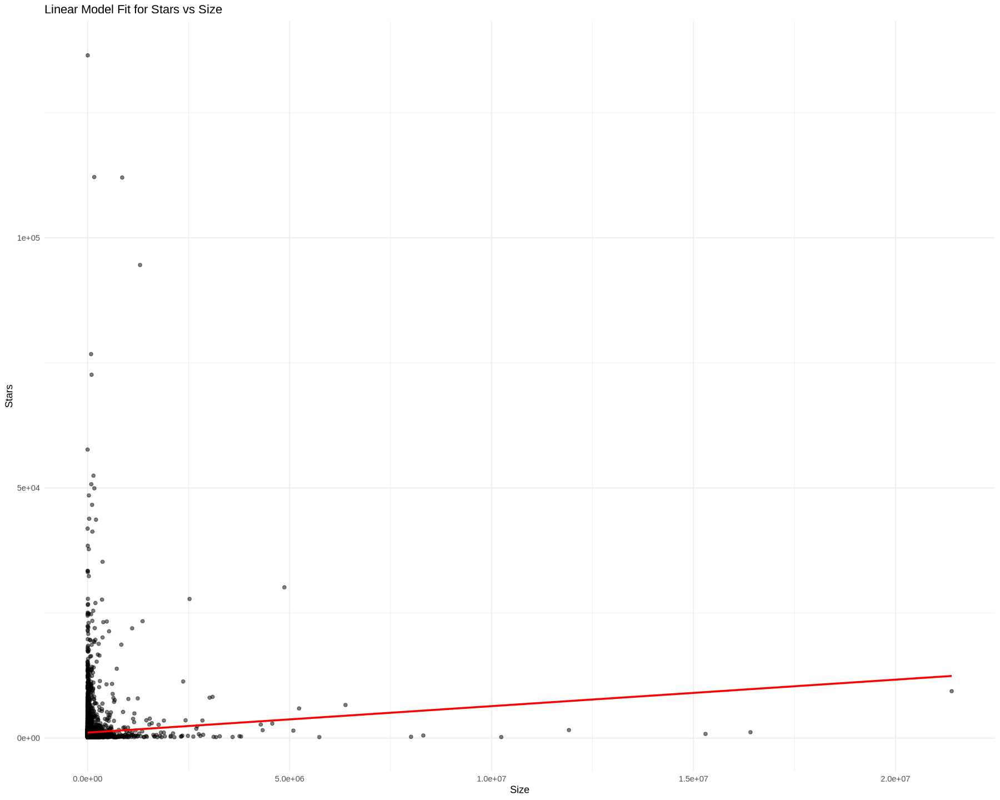

`geom_smooth()` using formula = 'y ~ x'


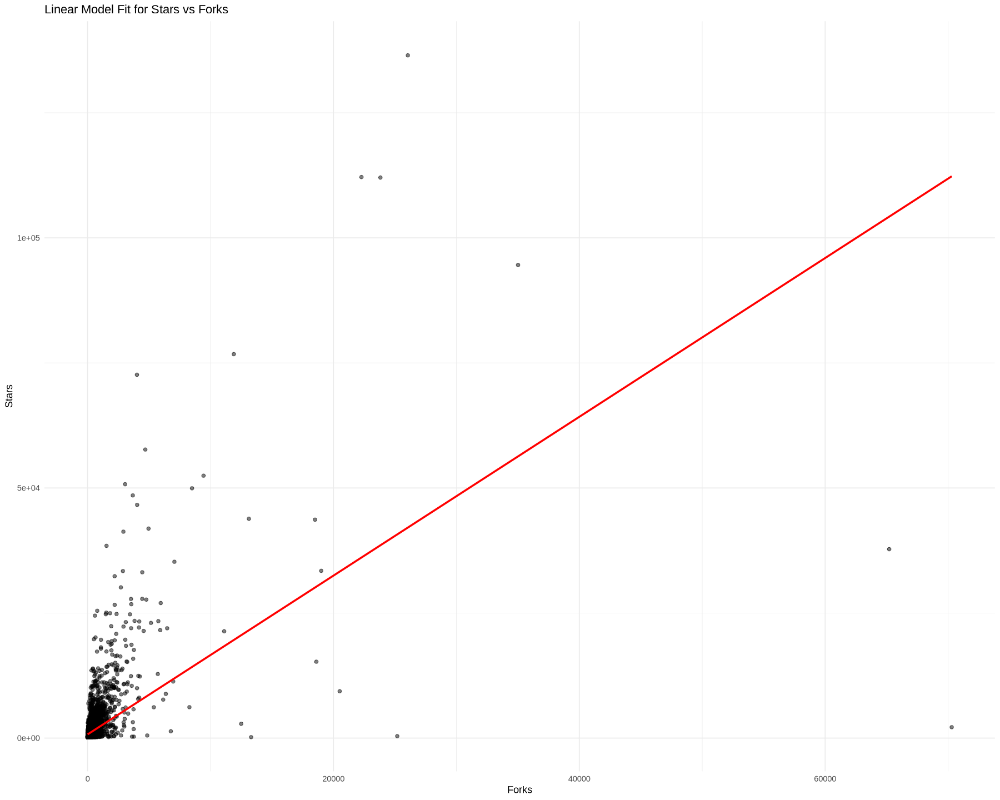

`geom_smooth()` using formula = 'y ~ x'


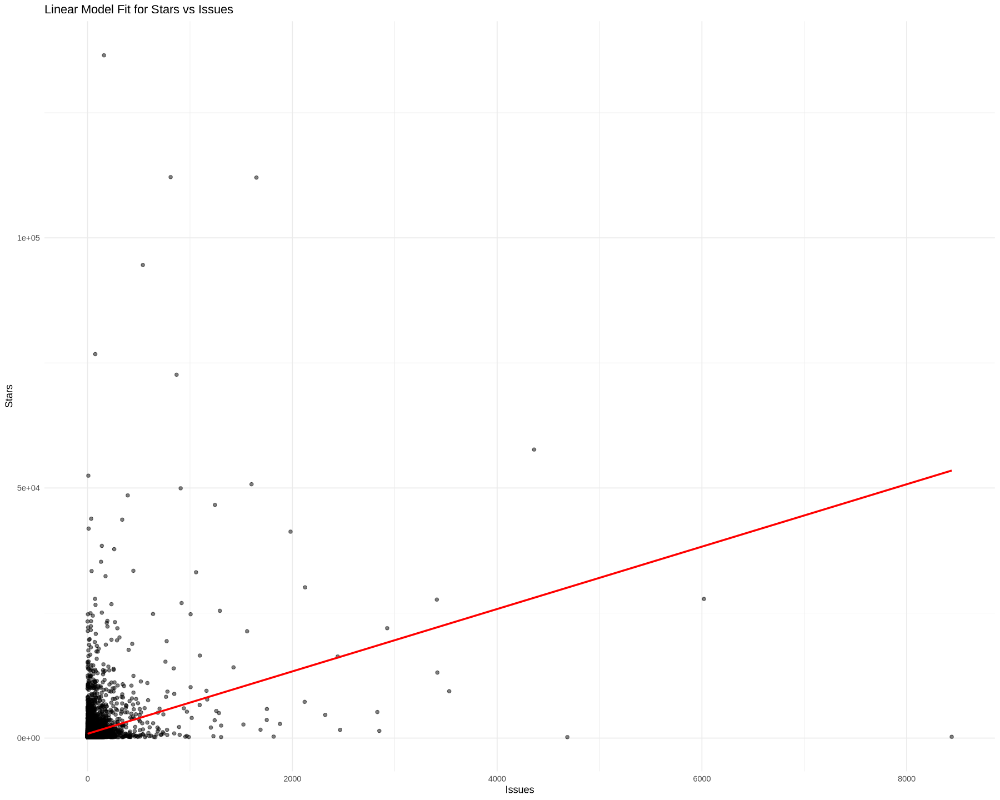

`geom_smooth()` using formula = 'y ~ x'


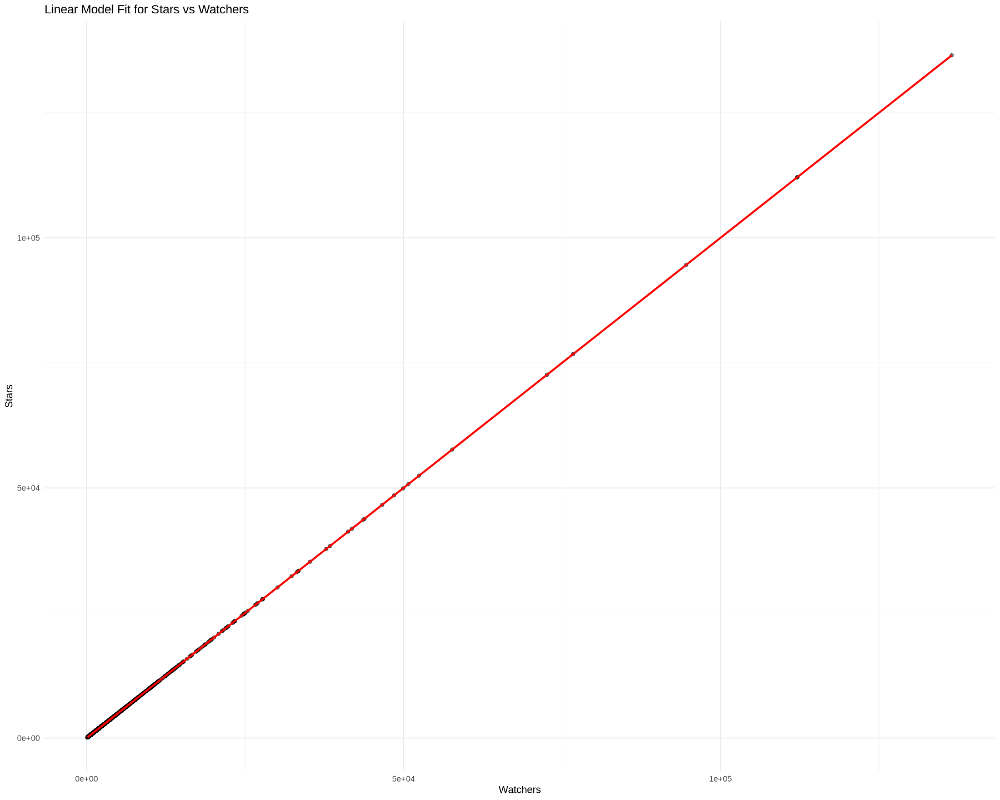

`geom_smooth()` using formula = 'y ~ x'


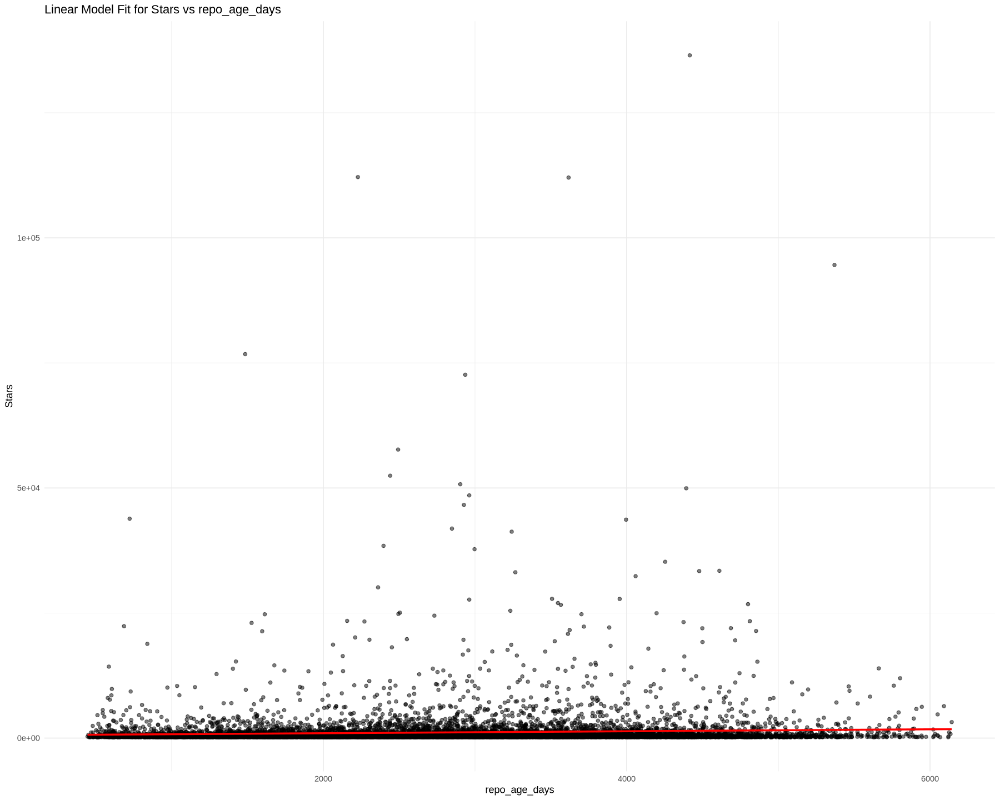

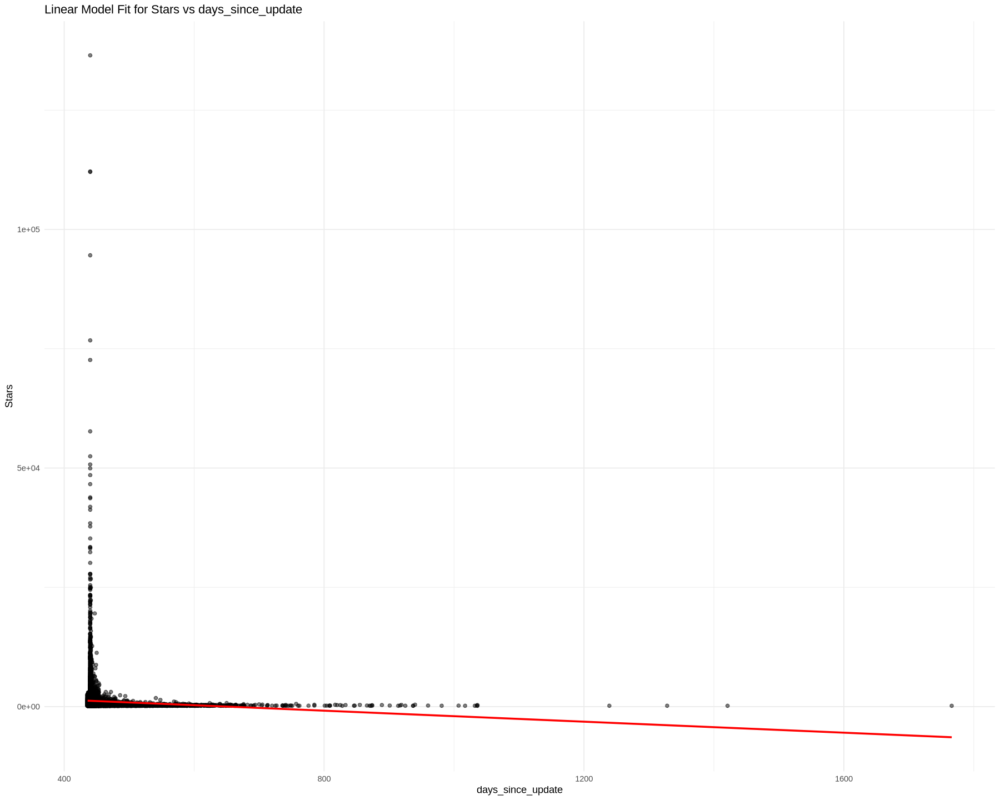

In [29]:
continuous_vars <- c("Size", "Forks", "Issues")

model <- lm(Stars ~ ., data = df_cleaned %>% select(Stars, all_of(continuous_vars)))

print(summary(model))

for (var in continuous_vars) {
  ggplot(df_cleaned, aes_string(x = var, y = "Stars")) +
    geom_point(alpha = 0.5) +
    geom_smooth(method = "lm", color = "red", se = FALSE) +
    labs(title = paste("Linear Model Fit for Stars vs", var)) +
    theme_minimal() -> p
    
  print(p)
}

*To investigate the presence of Multicollinearty, I am going to create a heat map to visulize
the corellation between input variables.*

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 12) 

df_cleaned_pair_plots <- 
    df_cleaned %>% 
    select(Size, Forks, Issues, Watchers, repo_age_days, days_since_update)%>% 
    ggpairs(progress = FALSE) +
    theme(text = element_text(size = 15))

df_cleaned_pair_plots

In [ ]:
corr_matrix_df_cleaned <- 
    df_cleaned %>%  
    select(Size, Forks, Issues, Watchers, repo_age_days, days_since_update) %>%
    cor() %>%
    as_tibble(rownames = 'var1') %>%
    pivot_longer(-var1, names_to = "var2", values_to = "corr")

head(corr_matrix_df_cleaned)

In [32]:
MLR_df_cleaned <- lm(formula = Stars ~ ., data = df_cleaned)

MLR_df_cleaned_results <- 
    tidy(MLR_df_cleaned) %>%
    mutate_if(is.numeric, round, 2)

head(MLR_df_cleaned_results)

Warning message in summary.lm(x):
“essentially perfect fit: summary may be unreliable”


term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),0,0,-1.240000e+00,0.22
Size,0,0,3.920000e+00,0.00
Forks,0,0,-4.074000e+01,0.00
Issues,0,0,-1.689000e+01,0.00
Watchers,1,0,1.794902e+17,0.00
`Is Archived`TRUE,0,0,2.000000e-02,0.98


In [33]:
VIF_MLR_df_cleaned <- vif(MLR_df_cleaned)

round(VIF_MLR_df_cleaned, 3)

ERROR: Error in vif(MLR_df_cleaned): could not find function "vif"


*We can see from the heat map that some of the input variables have a medium linear correlation. 
 e.g. Forks and Issues(0.667). In the next cell, we are going the find out what are their correlation coefficients.*

In this cell, I will split the data into training/testing data (80/20 ratio). I will use them to fit the linear regression model, predict 'Stars' values, and evaluate the model.  

In [77]:
set.seed(123) # DO NOT CHANGE!

GitHub_sample <-
    df_cleaned %>%
    mutate(id = row_number())

training_GitHub <- 
    GitHub_sample %>%
    slice_sample(prop = 0.80, replace = FALSE)

testing_GitHub <- 
    GitHub_sample %>% 
    anti_join(training_GitHub, by = "id") %>%
    select(-id)

training_GitHub <- 
    training_GitHub %>% 
    select(-id)

head(training_GitHub)
nrow(training_GitHub)

nrow(testing_GitHub)

Size,Stars,Forks,Issues,Watchers,Is Archived,Has Issues,Has Pages,repo_age_days,days_since_update
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<dbl>,<dbl>
1806,291,24,0,291,FALSE,TRUE,FALSE,927,441
176,181,17,0,181,FALSE,TRUE,FALSE,5450,560
250118,428,222,24,428,FALSE,TRUE,FALSE,2401,437
2205,515,86,36,515,FALSE,TRUE,FALSE,4527,461
15445,250,34,2,250,FALSE,TRUE,FALSE,3451,440
50,183,39,4,183,FALSE,TRUE,FALSE,1830,432


[1] 8000

[1] 2000

- One of the limitations I faced when running the Forward Selection Algorithm on the given data was that The kernel would collapse and restart entirely.
- To solve this problem, I will drop some of the categorical variables that have many levels (>2) and I, from the experience I gained in this course, believe they have little to no utility in predicting the number of stars.

In [78]:
GitHub_forward_sel <- regsubsets(
  Stars ~ ., data = training_GitHub,
  method = "forward",
  nvmax = ncol(training_GitHub) - 1
)
GitHub_forward_sel

GitHub_fwd_summary <- summary(GitHub_forward_sel)

GitHub_fwd_summary <- tibble(
  n_input_variables = 1:length(GitHub_fwd_summary$rss),  
  RSS = GitHub_fwd_summary$rss,
  BIC = GitHub_fwd_summary$bic,
  Cp = GitHub_fwd_summary$cp
)

Subset selection object
Call: regsubsets.formula(Stars ~ ., data = training_GitHub, method = "forward", 
    nvmax = ncol(training_GitHub) - 1)
9 Variables  (and intercept)
                  Forced in Forced out
Size                  FALSE      FALSE
Forks                 FALSE      FALSE
Issues                FALSE      FALSE
Watchers              FALSE      FALSE
`Is Archived`TRUE     FALSE      FALSE
`Has Issues`TRUE      FALSE      FALSE
`Has Pages`TRUE       FALSE      FALSE
repo_age_days         FALSE      FALSE
days_since_update     FALSE      FALSE
1 subsets of each size up to 9
Selection Algorithm: forward

In [79]:
GitHub_fwd_summary
summary(GitHub_forward_sel)

n_input_variables,RSS,BIC,Cp
<int>,<dbl>,<dbl>,<dbl>
1,4.357731e-19,-538133.9,628.845164
2,4.066121e-19,-538679.0,53.688930
3,4.037798e-19,-538725.9,-0.368246
4,4.037477e-19,-538717.6,0.997205
5,4.037134e-19,-538709.2,2.316943
6,4.037072e-19,-538700.4,4.194667
7,4.037007e-19,-538691.5,6.066094
8,4.036974e-19,-538682.6,8.000564
9,4.036973e-19,-538673.6,10.000000


Subset selection object
Call: regsubsets.formula(Stars ~ ., data = training_GitHub, method = "forward", 
    nvmax = ncol(training_GitHub) - 1)
9 Variables  (and intercept)
                  Forced in Forced out
Size                  FALSE      FALSE
Forks                 FALSE      FALSE
Issues                FALSE      FALSE
Watchers              FALSE      FALSE
`Is Archived`TRUE     FALSE      FALSE
`Has Issues`TRUE      FALSE      FALSE
`Has Pages`TRUE       FALSE      FALSE
repo_age_days         FALSE      FALSE
days_since_update     FALSE      FALSE
1 subsets of each size up to 9
Selection Algorithm: forward
         Size Forks Issues Watchers `Is Archived`TRUE `Has Issues`TRUE
1  ( 1 ) " "  " "   " "    "*"      " "               " "             
2  ( 1 ) " "  "*"   " "    "*"      " "               " "             
3  ( 1 ) " "  "*"   "*"    "*"      " "               " "             
4  ( 1 ) " "  "*"   "*"    "*"      "*"               " "             
5  ( 1 ) " "  "*"   "*

- based on the forward selection, the variables for the best-fit model are Size Forks Issues Watchers. Therefore I will fit the training data into a linear regression prediction model using an additive model for all the variables we just selected(4).
-  the reason I selected model (4) is that it has the best combination of lowest CP, BIC and the among the highest RSS.*

In [99]:
GitHub_full <- lm(Stars ~ Size + Forks + Issues + Watchers + `Is Archived`, data = training_GitHub)

GitHub_full


Call:
lm(formula = Stars ~ Size + Forks + Issues + Watchers + `Is Archived`, 
    data = training_GitHub)

Coefficients:
      (Intercept)               Size              Forks             Issues  
       -6.610e-14         -6.019e-21         -3.214e-16         -5.368e-16  
         Watchers  `Is Archived`TRUE  
        1.000e+00          4.625e-16  


In [100]:
GitHub_test_pred_full <- predict(GitHub_full, newdata = testing_GitHub)

head(GitHub_test_pred_full)

1    2    3    4    5    6 
1848  815  194  257  401  841

- including 'Watchers' in the model will lead to perfect prediction. This is because 'Watchers' = 'Stars'.
- Therefore the resulting RMSE will equal to 0 (or approximatly 0). 

- By using the vif function, and to resolve multicollinearity, I got the following results:
- Size: 1.001, Forks: 1.615, Issues: 1.441, Watchers: 2.042, `Has Discussions`: 1.051repo_age_days: 1.087, days_since_update: 1.071.
- I observed that 'Watchers' has a strong correlation with both 'Forks' and 'Issues' (0.62 and 0.55 respectively).
- Now let's fit a linear regression model by using the best-fit model result from Forward Selection.(without 'Watchers')
- Note: I could have removed 'Watchers' before running the Forward Selection Algorithm, however, I wanted to see what the algorithm would select as the best-fit model.

In [101]:
GitHub_No_Watchers <- lm(Stars ~ Forks + Issues + `Is Archived` , data = training_GitHub)

GitHub_No_Watchers


Call:
lm(formula = Stars ~ Forks + Issues + `Is Archived`, data = training_GitHub)

Coefficients:
      (Intercept)              Forks             Issues  `Is Archived`TRUE  
          543.753              1.893              3.094           -224.554  


In [102]:
GitHub_pred_No_Watchers <- predict(GitHub_No_Watchers, newdata = testing_GitHub)

head(GitHub_pred_No_Watchers)

1         2         3         4         5         6 
1395.6787  915.7885  633.0351  611.8851  735.5647  586.2328

- Since we saw in the previous assignment visualization that 'Watchers' was perfectly linearly correlated with Stars and also strongly correlated with 'Issues' and 'Forks', now let's fit a simple linear regression model with only 'Forks' as the input then only 'Issues as the input variable.*

In [107]:
GitHub_Simple_Forks <- lm(Stars ~ Forks, data = training_GitHub)


GitHub_Simple_Issues <- lm(Stars ~ Issues, data = training_GitHub)

GitHub_Simple_Forks
GitHub_Simple_Issues


Call:
lm(formula = Stars ~ Forks, data = training_GitHub)

Coefficients:
(Intercept)        Forks  
    609.813        2.053  



Call:
lm(formula = Stars ~ Issues, data = training_GitHub)

Coefficients:
(Intercept)       Issues  
    845.588        6.472  


In [109]:
GitHub_test_pred_Simple_Forks <- predict(GitHub_Simple_Forks, newdata = testing_GitHub)

GitHub_test_pred_Simple_Issues <- predict(GitHub_Simple_Issues, newdata = testing_GitHub)


head(GitHub_test_pred_Simple_Forks)
head(GitHub_test_pred_Simple_Issues)

1         2         3         4         5         6 
1443.2028  862.2931  689.8675  683.7095  784.2910  632.3924

1         2         3         4         5         6 
1020.3220 1136.8117  877.9458  845.5876  910.3040  890.8891

In [110]:
GitHub_RMSE_table <- bind_rows(
  tibble(
    Model = "Full Regression",
    RMSE = rmse(model = GitHub_full, data = testing_GitHub)
  ),
  tibble(
    Model = "Full Regression No Watchers",
    RMSE = rmse(model = GitHub_No_Watchers, data = testing_GitHub)
  ),
  tibble(
    Model = "Simple Regression (Forks)",
    RMSE = rmse(model = GitHub_Simple_Forks, data = testing_GitHub)
  ),
  tibble(
    Model = "Simple Regression (Issues)",
    RMSE = rmse(model = GitHub_Simple_Issues, data = testing_GitHub)
  )
)

GitHub_RMSE_table

Model,RMSE
<chr>,<dbl>
Full Regression,5.015018e-13
Full Regression No Watchers,1.980421e+03
Simple Regression (Forks),2.041780e+03
Simple Regression (Issues),2.435912e+03


- We can conclude from the RMSE values for all the models, except the one with 'Watchers', that the linear regression model that yielded the best prediction is the Forward Selection one (lowest RMSE).
- This was expected because, from the visualization of the relationship between input variables and 'Stars' (in the previous assignment), we saw how those variables had a weak linear correlation with the number of stars a repository has.

## Discussion: 


- The analysis of GitHub repository data revealed that certain features, such as Size, Forks, and Issues show significant correlations with Stars.
  - Implications: These findings suggest that the GitHub community highly values active contributions and project size.
  - For developers looking to gain visibility, regular updates and long-term project management might be critical strategies. Furthermore, it highlights the importance of continuous engagement with the community to maintain and grow a project's popularity.

- Were the Results Expected?
  - Yes, the results align with the expected findings. We anticipated that the size of the repository and the number of forks would correlate with higher star counts, as these factors are typically associated with increased engagement and project quality.

- Model Improvement:
  - Add more features: Introducing additional features like the number of contributors, issue resolution time, or repository license type could enhance the model's predictive power by accounting for more aspects of repository activity.
  - Model selection: Experimenting with more advanced regression techniques, such as random forest regression could capture more complex relationships and interactions between features.
  -  Outlier handling: Identifying and managing outliers, such as repositories with very high stars despite low activity, could lead to more robust model results.
  -  Cross-validation: Implementing cross-validation techniques would help assess the model's performance more thoroughly and prevent overfitting.

- Future Questions/Research:
  - Impact of contributor diversity: Future research could explore how the diversity of contributors (e.g., the number of unique contributors or contributions from well-known developers) influences the star count.
  - Project lifecycle and stars: Investigating how the timing of major updates, milestones, or releases correlates with star growth over time could provide valuable insights for project planning.
  - External factors: It would be interesting to study the influence of external factors such as social media activity or media coverage on project popularity, potentially incorporating data from Twitter or Reddit.
  - Causality vs. correlation: Future work could focus on determining whether frequent updates directly drive star growth or if other underlying factors are at play (correlation does not imply causation).

## Reference: 

- GitHub. (n.d.). Saving repositories with stars. GitHub Docs. https://docs.github.com/en/get-started/exploring-projects-on-github/saving-repositories-with-stars
- Barbos, D. (n.d.). GitHub repositories. Kaggle. https://www.kaggle.com/datasets/donbarbos/github-repos?resource=download
- I. J. Mojica Ruiz, M. Nagappan, B. Adams, T. Berger, S. Dienst, and A. E. Hassan, “Impact of ad libraries on ratings of Android mobile apps,” IEEE Software, vol. 31, no. 6, pp. 86–92, 2014.
- K. Aggarwal, A. Hindle, and E. Stroulia, “Co-evolution of project documentation and popularity within GitHub,” in 11th Working Conference on Mining Software Repositories (MSR), 2014, pp. 360–363.
